In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df =pd.read_csv("/content/drive/MyDrive/Dataset/IIT BHU - DS Assessment dataset/data.csv")

## Getting to know the data
- Imputing Null values (<20%)
- Removing and checking Duplicates
- Handling Outliers
- Missing value Columns : brand_name,category_name,subcategory_name - - -Product_name as the figure in below 10 % of missing data and they are categorical in nature we eplace and bundle them into others

In [ ]:
df.head(15).style.background_gradient(cmap='Set3')

,search_term,product_variant_id,city_id,query_type,is_clicked,total_clicks,session_views,query_products_clicks_last_30_days,CTR_last_30_days,CTR_last_7_days,CTR_product_30_days,query_product_plt_clicks_60_days,query_product_plt_ctr_60_days,CTR_plt_30_days,predicted_category_name,predicted_subcategory_name,query_product_plt_clicks_30_days,product_name,brand_name,category_name,subcategory_name,latest_margin,savings,savings_with_pass,ad_revenue,total_unique_orders,product_atcs_30_days,product_atcs_plt_30_days,total_unique_orders_plt_30_days,product_ctr_city_30_days,query_product_similarity
0,akshayakalpa milk,c442ad9b-09b6-4505-a17d-7d2b3cceee0e,ee66dc2a-aded-4445-a7b2-1ad63715725c,head,0.000000,0,0,0,0.000000,0.000000,0.000000,0,0.000000,0.234505,"{'Dairy, Bread & Eggs': 1, 'Cold Drinks & Juices': 0.5, 'Zepto Cafe': 2}","{'Milk': 1, 'Milk Drinks': 0.5, 'Yogurts & Dahi': 0.5, 'Baking Mixes & Ingredients': 0.5}",0,Cadbury Dairy Milk Chocolate Bar,Dairy Milk,Sweet Cravings,Chocolates,6.900000,0.040000,2.718400,0.000000,155,376,552508,167494,0.054913,0.384844
1,ice cubes,33e1c372-8f6b-4312-b4df-93911f4c1caf,7e926d2f-adad-4e5a-956f-f07fffa54164,head,0.000000,0,57,0,0.000000,0.000000,0.003239,0,0.000000,0.011633,"{'Ice Creams & More': 1, 'Zepto Cafe': 2}",{'Ice Cubes & Ice Pops': 1},0,Noto Roasted Hazelnut Bar Ice Cream Stick,Noto,Ice Creams & More,Sticks,42.010000,0.250000,5.009091,0.000000,14,41,3264,1313,0.003239,0.324977
2,protien,8ed8801e-f3bd-46ed-a212-24dcaa33d937,078d5e32-627a-4907-8df8-4360bc7c06da,head,1.000000,29,545,9,0.040179,0.000000,0.061085,317,0.053520,0.066489,"{'Munchies': 1, 'Health & Wellness': 0.5, 'Zepto Cafe': 2}","{'Energy Bars': 1, 'Fitness': 0.5, 'Cookies': 0.5, 'Muesli & Oats': 0.5}",198,"RiteBite Max Protein Cookies Choco Chips Biscuits Cookies, No Maida",Max Protien,Munchies,Energy Bars,10.243929,0.160000,3.239500,18.622949,1469,3335,55215,24085,0.061085,0.220603
3,comb,b16224dd-5b0b-4e39-91d0-b52e563c70c2,4f30407c-6a3c-4a4e-8a3d-652217d4b6cb,head,0.000000,0,13,0,0.000000,0.000000,0.000000,0,0.000000,0.258667,"{'Cleaning Essentials': 1, 'Electricals & Accessories': 0.5, 'Zepto Cafe': 2}","{'Laundry Additives': 1, 'Home Electronics': 0.5, 'Hygiene Essentials': 0.5, 'Floor & Surface Cleaners': 0.5}",0,Bisleri Packaged Drinking Water Jar,Bisleri,Cold Drinks & Juices,Water,21.433421,0.000000,5.118421,0.000000,14567,28849,216304,121334,0.120340,0.061622
4,nail polish remover,25efac15-9a86-4da1-ab36-94e32bc7ecd9,4f30407c-6a3c-4a4e-8a3d-652217d4b6cb,tail,0.000000,0,1,0,0.000000,0.000000,0.052714,0,0.000000,0.000000,"{'Makeup & Beauty': 1, 'Grooming Essentials': 0.5, 'Zepto Cafe': 2}","{'Nails': 1, 'Beauty Accessories': 0.5, 'Hygiene Essentials': 0.5}",0,Veet Hair Removal Wax Strips - Sensitive Skin,Veet,Feminine Hygiene,Hair Removal,13.487105,0.036957,4.915103,20.365139,1043,2446,14527,6418,0.052714,0.390254
5,zero,fb735a3d-13e8-49d3-aca2-eb1d2b33ad11,ee66dc2a-aded-4445-a7b2-1ad63715725c,head,0.000000,0,9,0,0.000000,0.000000,0.007960,360,0.098874,0.014524,"{'Cold Drinks & Juices': 1, 'Ice Creams & More': 0.5, 'Zepto Cafe': 2}","{'Soft Drinks': 1, 'Non-Alco & Energy Drink': 0.5, 'Cups': 0.5, 'Ice Cubes & Ice Pops': 0.5}",204,Paper Boat Zero Ginger Lemon Sparkling Water,Paper Boat,Cold Drinks & Juices,Water,15.210000,0.066667,4.649333,12.401136,21,30,6883,3741,0.007960,0.205596
6,room freshner,712cd5f8-ea6b-4572-8534-ec9885c81a34,7e926d2f-adad-4e5a-956f-f07fffa54164,tail,1.000000,1,99,0,0.000000,0.000000,0.005562,5,0.035714,0.009464,"{'Cleaning Essentials': 1, 'Zepto Cafe': 2}","{'Fresheners': 1, 'Toilet & Bathroom Cleaners': 0.5, 'Floor & Surface Cleaners': 0.5}",10,Wonder Fresh Lemon Room Freshener,WonderFresh,Cleaning Essentials,Fresheners,9.640000,0.603352,2.741285,0.000000,10,13,324,149,0.005562,0.593330
7,chocos,b9606e95-79a6-4814-827d-104b680ca81f,facade53-8330-4ebe-b07e-55319220a301,head,1.000000,57,7513,30,0.008439,0.007837,0.034937,730,0.014811,0.089566,"{'Breakfast & Sauces': 1, 'Biscuits': 0.5, 'Zepto 

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 504989 entries, 0 to 504988
Data columns (total 31 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   search_term                         504989 non-null  object 
 1   product_variant_id                  504989 non-null  object 
 2   city_id                             504989 non-null  object 
 3   query_type                          504989 non-null  object 
 4   is_clicked                          504989 non-null  float64
 5   total_clicks                        504989 non-null  int64  
 6   session_views                       504989 non-null  int64  
 7   query_products_clicks_last_30_days  504989 non-null  int64  
 8   CTR_last_30_days                    504989 non-null  float64
 9   CTR_last_7_days                     504989 non-null  float64
 10  CTR_product_30_days                 504989 non-null  float64
 11  query_product_plt_clicks_6

In [ ]:
df.isnull().sum()*100/len(df)

,0
search_term,0.000000
product_variant_id,0.000000
city_id,0.000000
query_type,0.000000
is_clicked,0.000000
total_clicks,0.000000
session_views,0.000000
query_products_clicks_last_30_days,0.000000
CTR_last_30_days,0.000000
CTR_last_7_days,0.000000


In [ ]:
df["brand_name"].fillna("None",inplace=True)
df["category_name"].fillna("unlisted",inplace=True)
df["subcategory_name"].fillna("others",inplace=True)
df["product_name"].fillna("None",inplace=True)

In [ ]:
# Checking for duplicates
print(df.duplicated().sum())

0


In [ ]:
df.iloc[0]

,0
search_term,akshayakalpa milk
product_variant_id,c442ad9b-09b6-4505-a17d-7d2b3cceee0e
city_id,ee66dc2a-aded-4445-a7b2-1ad63715725c
query_type,head
is_clicked,0.0
total_clicks,0
session_views,0
query_products_clicks_last_30_days,0
CTR_last_30_days,0.0
CTR_last_7_days,0.0


## EDA Insights
- Combo ,Zepto and much are the top searched items
- Munchies ,Sweet Craving and home essential categories are most searched categories
- Click through rate on the platform is very low averaging near .1 for most features assigned,CTR of last 30 days (P*Q*C) lies near 0 and above 1 % only 32 searches for that query in given cities exist
- CTR (PxQxC) for 30 days and 7 days are correlated postively
- Popular queries ,product suggestions are clicked more often than tail query type



In [ ]:
search_term_counts = df['search_term'].value_counts()

# Select top 10
top_10_search_terms = search_term_counts.head(10)

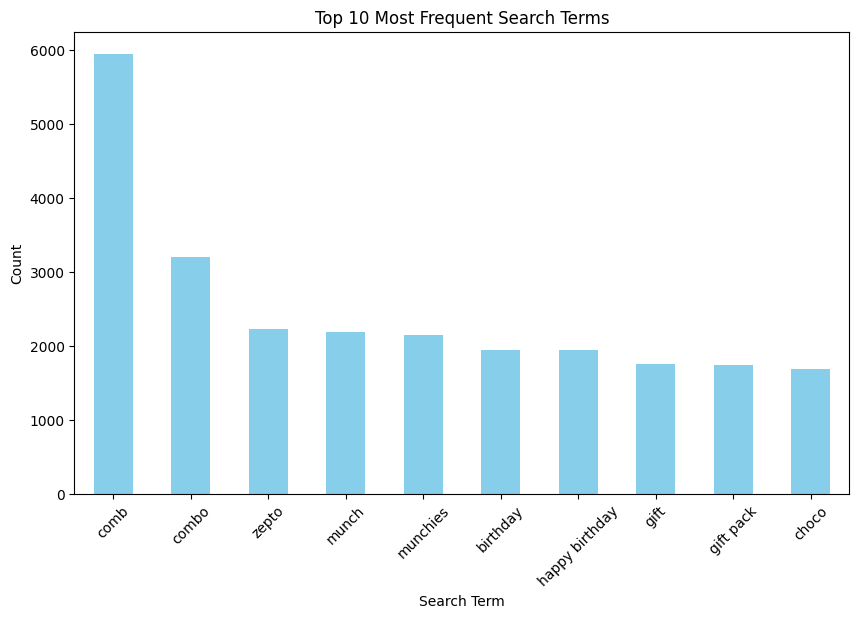

In [ ]:
plt.figure(figsize=(10, 6))
top_10_search_terms.plot(kind='bar', color='skyblue')
plt.title('Top 10 Most Frequent Search Terms')
plt.xlabel('Search Term')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

In [ ]:
df_group=df.copy()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np


city_counts = df["city_id"].value_counts()

colors = plt.cm.Paired(np.linspace(0, 1, len(city_counts)))

px.histogram(df, x= 'city_id', color="is_clicked", histfunc='count', range_x=(0,10))


<ipython-input-63-d414cc36ce26>:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




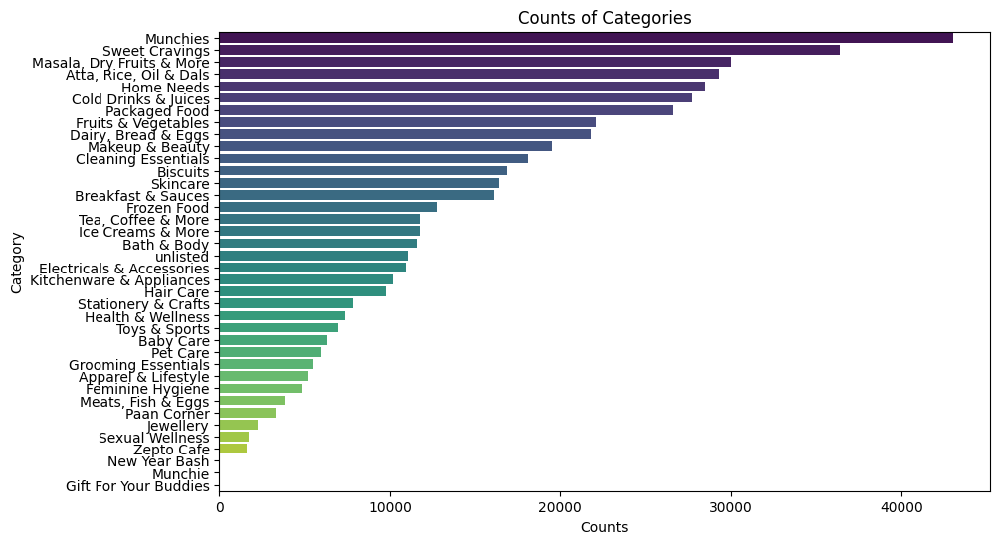

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

counts = df["category_name"].value_counts()
data = counts.reset_index()
data.columns = ['category_name', 'count']
plt.figure(figsize=(10, 6))
sns.barplot(x='count', y='category_name', data=data, palette='viridis')
plt.xlabel('Counts')
plt.ylabel('Category')
plt.title('Counts of Categories')
plt.show()



3.0
0.0
0.008794644123072742
32


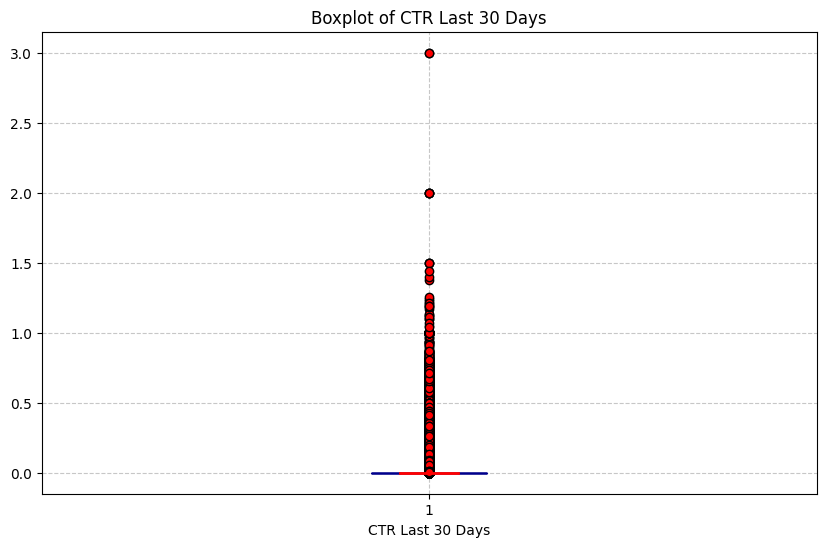

In [ ]:
print(df["CTR_last_30_days"].max())
print(df["CTR_last_30_days"].min())
print(df["CTR_last_30_days"].mean())
temp= df[df["CTR_last_30_days"]>1]
print(len(temp))
plt.figure(figsize=(10, 6))
plt.boxplot(df["CTR_last_30_days"],
            patch_artist=True,
            boxprops=dict(facecolor='skyblue', color='darkblue'),
            whiskerprops=dict(color='darkblue'),
            capprops=dict(color='darkblue'),
            medianprops=dict(color='red', linewidth=2),
            flierprops=dict(markerfacecolor='red', marker='o'),
            notch=True)
plt.xlabel('CTR Last 30 Days')
plt.title('Boxplot of CTR Last 30 Days')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

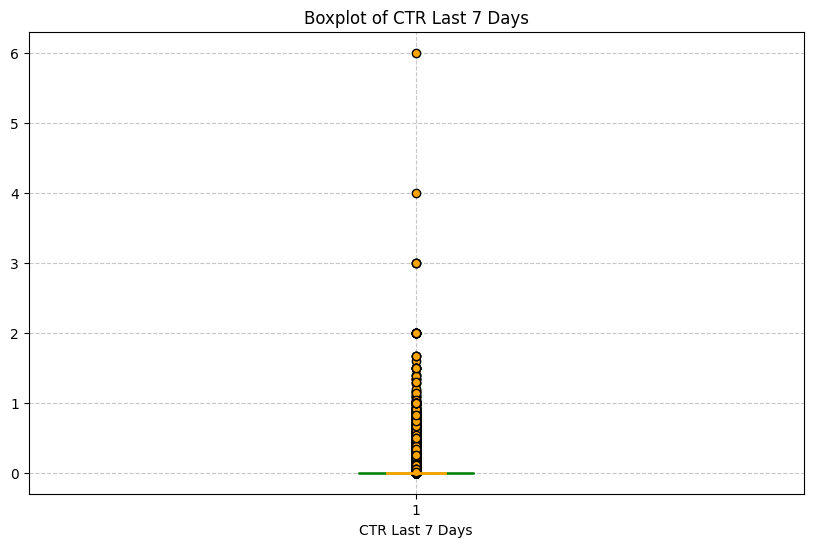

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.boxplot(df["CTR_last_7_days"],
            patch_artist=True,
            boxprops=dict(facecolor='lightgreen', color='green'),
            whiskerprops=dict(color='green'),
            capprops=dict(color='green'),
            medianprops=dict(color='orange', linewidth=2),
            flierprops=dict(markerfacecolor='orange', marker='o'),
            notch=True)
plt.xlabel('CTR Last 7 Days')
plt.title('Boxplot of CTR Last 7 Days')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


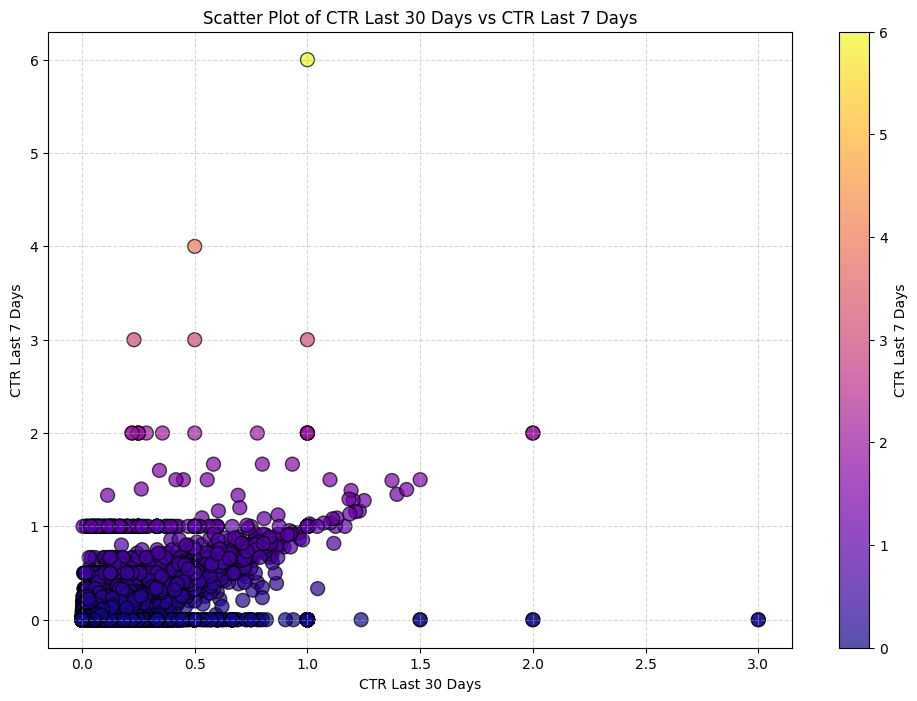

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
plt.scatter(df["CTR_last_30_days"], df["CTR_last_7_days"],
            c=df["CTR_last_7_days"], cmap='plasma',
            edgecolor='k', alpha=0.7, s=100)
plt.colorbar(label='CTR Last 7 Days')
plt.xlabel('CTR Last 30 Days')
plt.ylabel('CTR Last 7 Days')
plt.title('Scatter Plot of CTR Last 30 Days vs CTR Last 7 Days')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


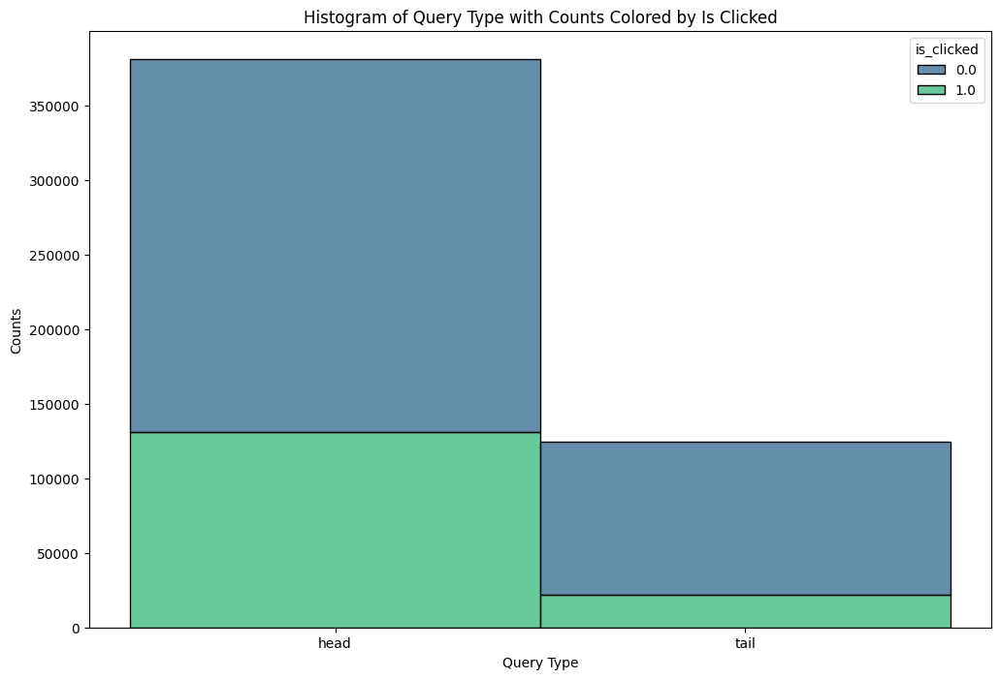

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
sns.histplot(data=df, x='query_type', hue='is_clicked', multiple='stack', palette='viridis', bins=len(df['query_type'].unique()))
plt.xlabel('Query Type')
plt.ylabel('Counts')
plt.title('Histogram of Query Type with Counts Colored by Is Clicked')
plt.show()


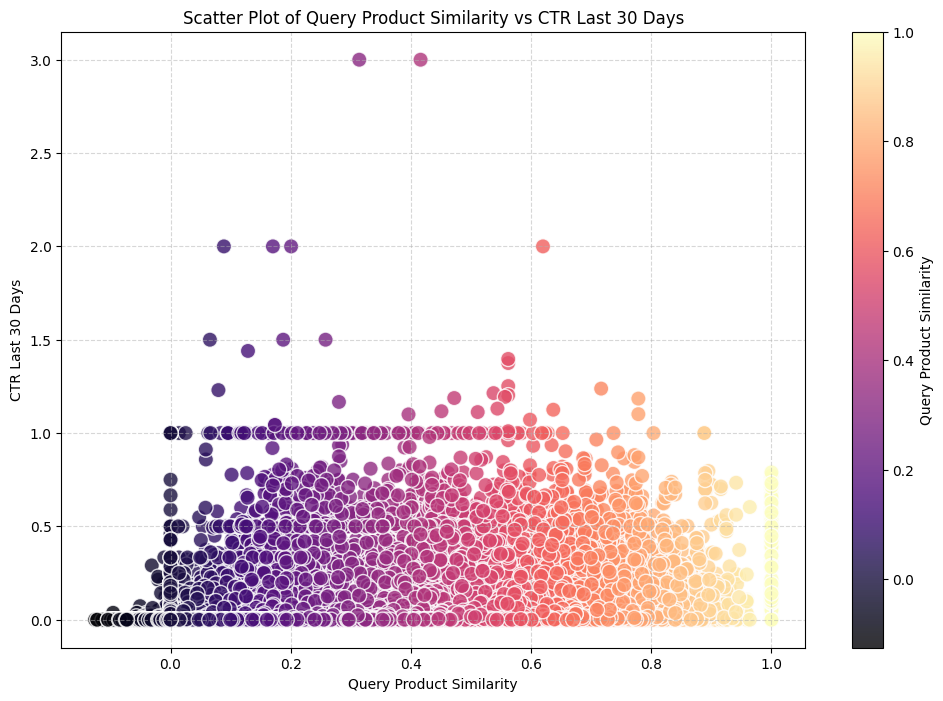

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
scatter = plt.scatter(df["query_product_similarity"], df["CTR_last_30_days"],
                      c=df["query_product_similarity"], cmap='magma',
                      edgecolor='w', alpha=0.8, s=120,
                      marker='o')
plt.colorbar(scatter, label='Query Product Similarity')
plt.xlabel('Query Product Similarity')
plt.ylabel('CTR Last 30 Days')
plt.title('Scatter Plot of Query Product Similarity vs CTR Last 30 Days')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()



<ipython-input-75-149c64925310>:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




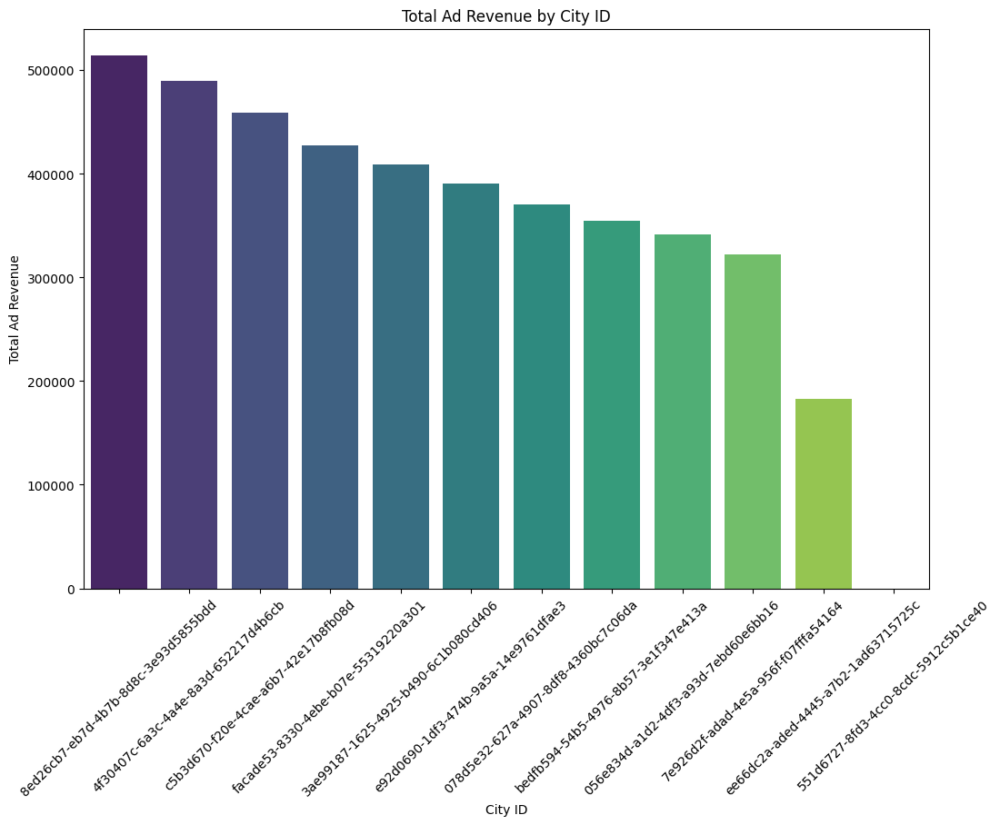

In [ ]:

city_revenue = df.groupby('city_id')['ad_revenue'].sum().reset_index()
city_revenue = city_revenue.sort_values(by='ad_revenue', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='city_id', y='ad_revenue', data=city_revenue, palette='viridis')
plt.xlabel('City ID')
plt.ylabel('Total Ad Revenue')
plt.title('Total Ad Revenue by City ID')
plt.xticks(rotation=45)
plt.show()


## Model Building
- Data Preprocessing(Endcoding ,feature engineering ,feature selection)
- Model selection (Rank to learn method)
- Using Feature Importance to select multiple features
- training to optimise the model

In [ ]:
num_cols=[]
for col in df.columns:
  if df[col].dtype!='object':
    num_cols.append(col)

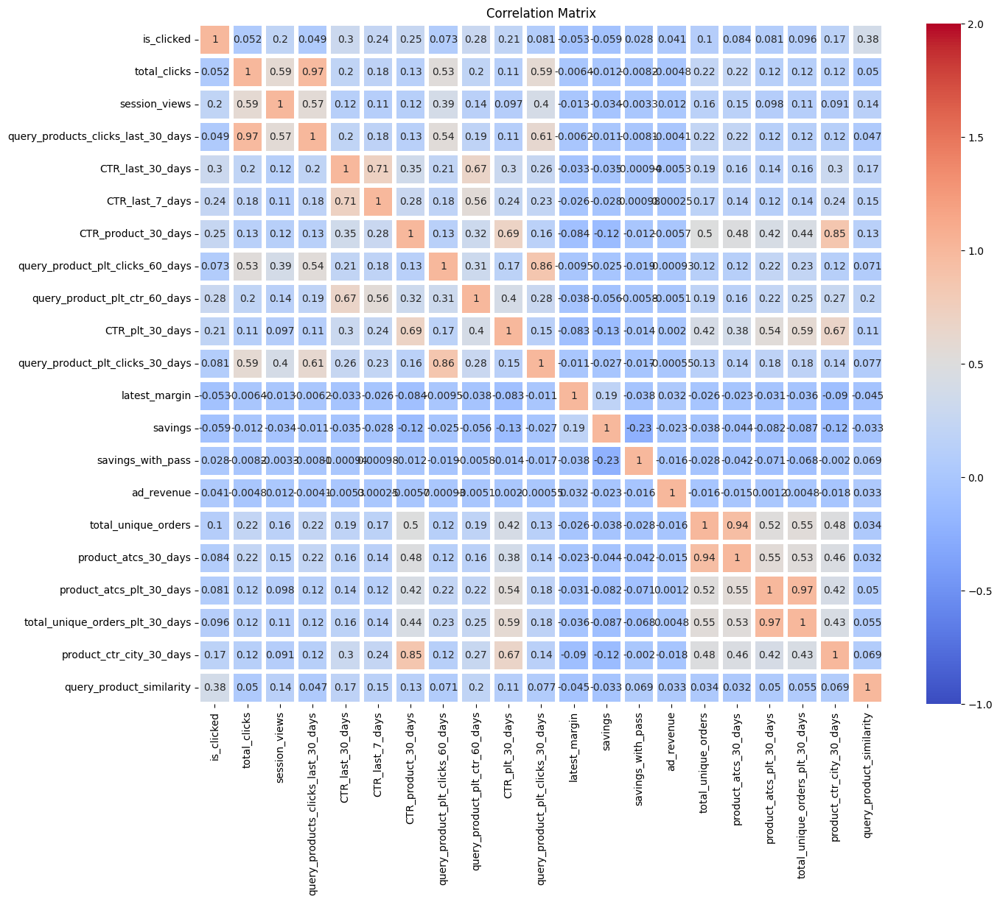

In [ ]:
tf=df[num_cols]
corr_matrix = tf.corr()
plt.figure(figsize=(15, 12))  # Adjust the figure size as needed
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=4, vmin=-1, vmax=2)
plt.title('Correlation Matrix')
plt.show()

In [ ]:
obj_col=[]
for col in df.columns:
  if df[col].dtype=='object':
    obj_col.append(col)

In [ ]:
numerical_feats=num_cols

In [ ]:
corr_arr = df[numerical_feats].corr().to_numpy()
for idxloc in np.argwhere(corr_arr>0.7):
    i, j = idxloc
    if (numerical_feats[i] != numerical_feats[j]) and (i < j):
        print(f"`{numerical_feats[i]}` & `{numerical_feats[j]}` are highly correlated with a corrcoeff = {round(corr_arr[i][j], 2)}")


`total_clicks` & `query_products_clicks_last_30_days` are highly correlated with a corrcoeff = 0.97
`CTR_last_30_days` & `CTR_last_7_days` are highly correlated with a corrcoeff = 0.71
`CTR_product_30_days` & `product_ctr_city_30_days` are highly correlated with a corrcoeff = 0.85
`query_product_plt_clicks_60_days` & `query_product_plt_clicks_30_days` are highly correlated with a corrcoeff = 0.86
`total_unique_orders` & `product_atcs_30_days` are highly correlated with a corrcoeff = 0.94
`product_atcs_plt_30_days` & `total_unique_orders_plt_30_days` are highly correlated with a corrcoeff = 0.97


In [ ]:
# We drop total click as total clicks give less information than query product clicks in last 30 days
# Ctr of last 7 days is more important in showing rranking that what was in last 30 days, as customers are clicking on a certain type in the present 7 days showing more inclination in recency
#they both are thr similar so randomly droppng one
#
#
num_drop_cols=["query_products_clicks_last_30_days","CTR_last_30_days","product_ctr_city_30_days","query_product_plt_clicks_60_days","total_unique_orders","total_unique_orders_plt_30_days"]

In [ ]:
for col in num_drop_cols:
  df.drop(col,axis=1,inplace=True)

In [ ]:
numerical_features

[]

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 504989 entries, 0 to 504988
Data columns (total 25 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   search_term                       504989 non-null  object 
 1   product_variant_id                504989 non-null  object 
 2   city_id                           504989 non-null  object 
 3   query_type                        504989 non-null  object 
 4   is_clicked                        504989 non-null  float64
 5   total_clicks                      504989 non-null  int64  
 6   session_views                     504989 non-null  int64  
 7   CTR_last_7_days                   504989 non-null  float64
 8   CTR_product_30_days               504989 non-null  float64
 9   query_product_plt_ctr_60_days     504989 non-null  float64
 10  CTR_plt_30_days                   504989 non-null  float64
 11  predicted_category_name           504989 non-null  o

In [ ]:
numerical_features=[]
for i in numerical_features:
  if df[i].dtype!="object":
    numerical_features.append(i)

In [ ]:
numerical_features = [i for i in numerical_features if df[i].dtype in ['int64', 'float64']]

print(numerical_features)

[]


In [ ]:
num_cols

['is_clicked',
 'total_clicks',
 'session_views',
 'query_products_clicks_last_30_days',
 'CTR_last_30_days',
 'CTR_last_7_days',
 'CTR_product_30_days',
 'query_product_plt_clicks_60_days',
 'query_product_plt_ctr_60_days',
 'CTR_plt_30_days',
 'query_product_plt_clicks_30_days',
 'latest_margin',
 'savings',
 'savings_with_pass',
 'ad_revenue',
 'total_unique_orders',
 'product_atcs_30_days',
 'product_atcs_plt_30_days',
 'total_unique_orders_plt_30_days',
 'product_ctr_city_30_days',
 'query_product_similarity']

In [ ]:
num_cols=[]
for col in df.columns:
  if df[col].dtype!='object':
    num_cols.append(col)

In [ ]:
num_cols

['is_clicked',
 'total_clicks',
 'session_views',
 'CTR_last_7_days',
 'CTR_product_30_days',
 'query_product_plt_ctr_60_days',
 'CTR_plt_30_days',
 'query_product_plt_clicks_30_days',
 'latest_margin',
 'savings',
 'savings_with_pass',
 'ad_revenue',
 'product_atcs_30_days',
 'product_atcs_plt_30_days',
 'query_product_similarity']

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
df[num_cols] = scaler.fit_transform(df[num_cols])

In [ ]:
!pip install category_encoders

In [ ]:
df.drop(columns=["total_clicks"], inplace=True)

In [ ]:
## Target encoding the categorical columns as One hot encoder will explode dimentionality , label encoder will give numerical indication for each , while target encoding gives a value based on most likelihodd , which is condusive to Ranking
import pandas as pd
import category_encoders as ce
for i in obj_col:
  # Initialize the target encoder
  target_encoder = ce.TargetEncoder(cols=[i])

  # Fit and transform the data
  df_encoded = target_encoder.fit_transform(df[i], df['is_clicked'])
  df[i+'_encoded'] = df_encoded

In [ ]:
df_final=df.copy()

In [ ]:
df_final.drop(obj_col,axis=1,inplace=True)

In [ ]:
df_final.head().style.background_gradient(cmap='cubehelix')

,is_clicked,session_views,CTR_last_7_days,CTR_product_30_days,query_product_plt_ctr_60_days,CTR_plt_30_days,query_product_plt_clicks_30_days,latest_margin,savings,savings_with_pass,ad_revenue,product_atcs_30_days,product_atcs_plt_30_days,query_product_similarity,search_term_encoded,product_variant_id_encoded,city_id_encoded,query_type_encoded,predicted_category_name_encoded,predicted_subcategory_name_encoded,product_name_encoded,brand_name_encoded,category_name_encoded,subcategory_name_encoded
0,-0.659016,-0.145599,-0.159513,-0.541074,-0.232637,4.240019,-0.055609,-0.238526,-0.818417,-0.561908,-0.520786,-0.089942,5.616422,0.432056,-0.527497,0.202875,-0.231400,0.089039,-0.121763,-0.527497,0.321492,-0.059142,0.021957,-0.001842
1,-0.659016,-0.139350,-0.159513,-0.412022,-0.232637,-0.298698,-0.055609,-0.073222,0.406682,0.447610,-0.520786,-0.116470,-0.126256,0.088089,-0.168924,0.106482,-0.095776,0.089039,0.272627,-0.168924,0.106482,0.272996,0.217038,0.224324
2,1.517414,-0.085856,-0.159513,1.892918,0.916267,0.818422,0.017434,-0.222783,-0.118360,-0.332257,0.628370,0.144376,0.416923,-0.511589,0.024634,0.366449,-0.029814,0.089039,0.313844,0.024634,0.366449,0.103603,0.050635,0.022644
3,-0.659016,-0.144174,-0.159513,-0.541074,-0.232637,4.732069,-0.055609,-0.170100,-1.051770,0.495792,-0.520786,2.164780,2.101206,-1.425017,-0.589481,0.764669,0.075670,0.089039,-0.504995,-0.589481,0.578403,0.310776,0.101332,0.120389
4,-0.659016,-0.145489,-0.159513,1.559368,-0.232637,-0.535596,-0.055609,-0.207513,-0.836172,0.406189,0.735874,0.073978,-0.008494,0.463139,0.435146,0.331162,0.075670,-0.273115,-0.038656,0.435146,0.380476,0.007080,0.240931,-0.002345


In [ ]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 504989 entries, 0 to 504988
Data columns (total 29 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   is_clicked                          504989 non-null  float64
 1   session_views                       504989 non-null  int64  
 2   CTR_last_30_days                    504989 non-null  float64
 3   CTR_last_7_days                     504989 non-null  float64
 4   CTR_product_30_days                 504989 non-null  float64
 5   query_product_plt_clicks_60_days    504989 non-null  int64  
 6   query_product_plt_ctr_60_days       504989 non-null  float64
 7   CTR_plt_30_days                     504989 non-null  float64
 8   query_product_plt_clicks_30_days    504989 non-null  int64  
 9   latest_margin                       504989 non-null  float64
 10  savings                             504989 non-null  float64
 11  savings_with_pass         

# Model Building with all features
- dropping features which directly affect the target variable

In [ ]:
df_final['group_id'] = df_final['search_term_encoded'].astype(str) + '_' + df_final['city_id_encoded'].astype(str)
df_final['group_id_encoded'] = pd.factorize(df_final['group_id'])[0]

In [ ]:
X = df_final.drop(columns=['is_clicked', 'group_id', 'group_id_encoded'])
y = df_final['is_clicked']

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
qid_train = df_final.loc[X_train.index, 'group_id_encoded'].values
qid_test = df_final.loc[X_test.index, 'group_id_encoded'].values

In [ ]:
params = {
    'objective': 'rank:pairwise',
    'eta': 0.1,
    'max_depth': 6,
    'eval_metric': 'ndcg'
}

In [ ]:
import xgboost as xgb
model = xgb.XGBRanker(**params)

In [ ]:
# Sort the training data and qid based on qid values
sorted_indices = np.argsort(qid_train)
X_train_sorted = X_train.iloc[sorted_indices]
y_train_sorted = y_train.iloc[sorted_indices]
qid_train_sorted = qid_train[sorted_indices]

# Fit the model using the sorted data
model.fit(X_train_sorted, y_train_sorted, qid=qid_train_sorted)

XGBRanker(base_score=None, booster=None, callbacks=None, colsample_bylevel=None,
          colsample_bynode=None, colsample_bytree=None, device=None,
          early_stopping_rounds=None, enable_categorical=False, eta=0.1,
          eval_metric='ndcg', feature_types=None, gamma=None, grow_policy=None,
          importance_type=None, interaction_constraints=None,
          learning_rate=None, max_bin=None, max_cat_threshold=None,
          max_cat_to_onehot=None, max_delta_step=None, max_depth=6,
          max_leaves=None, min_child_weight=None, missing=nan,
          monotone_constraints=None, multi_strategy=None, n_estimators=None,
          n_jobs=None, num_parallel_tree=None, ...)

In [ ]:
from sklearn.metrics import roc_auc_score

# Assuming you have true labels for the test set
y_test_pred = model.predict(X_test)

In [ ]:
# print(f"AUC Score: {roc_auc_score(y_test, y_test_pred)}")

In [ ]:
y_pred = model.predict(X_test)

In [ ]:
import numpy as np
from sklearn.metrics import ndcg_score, average_precision_score

def get_ndcg_score(y_true, y_pred, qid):
    unique_qid = np.unique(qid)
    y_true_list = []
    y_pred_list = []
    for u in unique_qid:
        # Only include queries with more than one document
        if (qid == u).sum() > 1:
            y_true_list.append(y_true[qid == u].values)
            y_pred_list.append(y_pred[qid == u])

    # Pad shorter lists with 0 to ensure equal lengths
    max_length = max(len(l) for l in y_true_list + y_pred_list)
    y_true_list = [np.pad(l, (0, max_length - len(l)), 'constant') for l in y_true_list]
    y_pred_list = [np.pad(l, (0, max_length - len(l)), 'constant') for l in y_pred_list]

    return ndcg_score(y_true_list, y_pred_list)

ndcg = get_ndcg_score(y_test, y_pred, qid_test)
print(ndcg)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_ranking.py:1807: FutureWarning: ndcg_score should not be used on negative y_true values. ndcg_score will raise a ValueError on negative y_true values starting from version 1.4.
  warnings.warn(


0.8626089235223979


In [ ]:
y_pred

array([-1.9315147, -2.1222093, -3.1008067, ..., -3.077055 , -4.2430964,
        1.2346673], dtype=float32)

In [ ]:
# from sklearn.metrics import ndcg_score, average_precision_score
# average_precision = average_precision_score(y_test, y_pred)
# print(f"Average Precision Score: {average_precision}")

In [ ]:
X["session_views"].max()

156.95405752986528

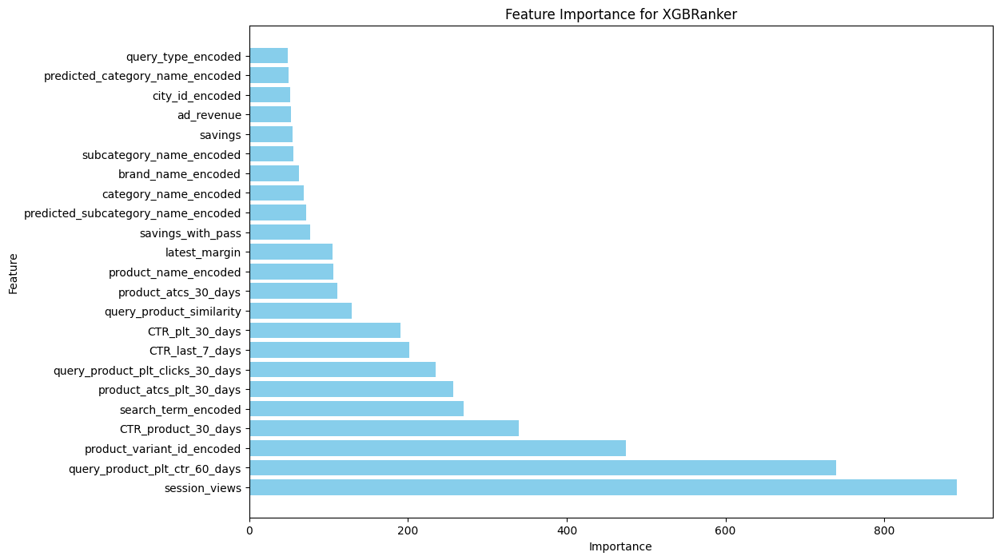

In [ ]:
importance = model.get_booster().get_score(importance_type='weight')

# Convert to DataFrame for easier manipulation
importance_df = pd.DataFrame(importance.items(), columns=['Feature', 'Importance'])
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Plot the feature importance
plt.figure(figsize=(12, 8))
plt.barh(importance_df['Feature'], importance_df['Importance'], color='skyblue')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance for XGBRanker')
plt.show()


In [ ]:
print(f"AUC Score: {roc_auc_score(y_test, y_test_pred)}")

AUC Score: 0.9829728816375947


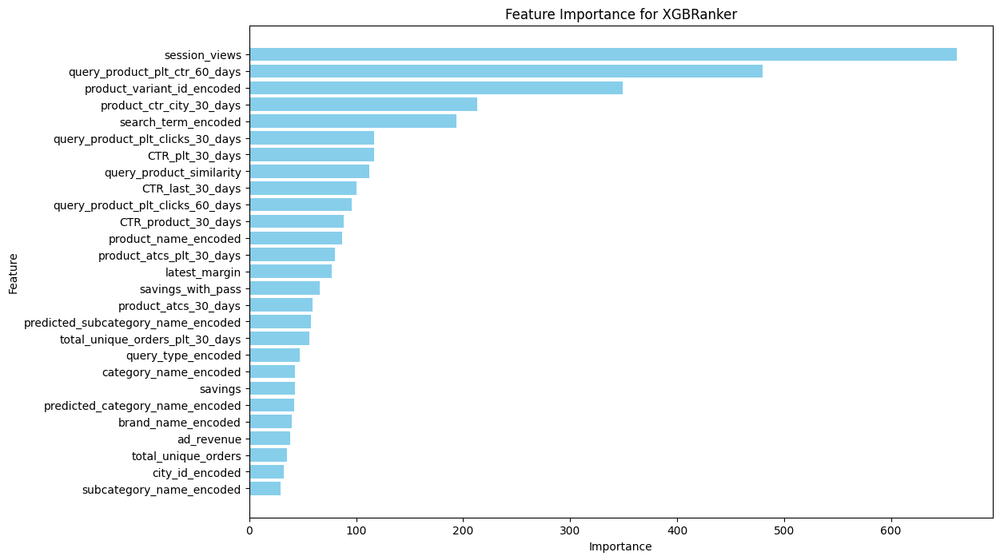

In [ ]:
importance = model.get_booster().get_score(importance_type='weight')

# Convert to DataFrame for easier manipulation
importance_df = pd.DataFrame(importance.items(), columns=['Feature', 'Importance'])
importance_df = importance_df.sort_values(by='Importance', ascending=True)

# Plot the feature importance
plt.figure(figsize=(12, 8))
plt.barh(importance_df['Feature'], importance_df['Importance'], color='skyblue')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance for XGBRanker')
plt.show()


In [ ]:
unique_groups = np.unique(qid_test)

In [ ]:
def ranking(X,y,quid):
  y_pred=model.predict(X)
  score = pd.Series(y_pred, name='score')
  df_combined = pd.concat([X, score], axis=1)
  df_sorted = df_combined.sort_values(by='score', ascending=False)
  return df_sorted

In [ ]:
qid_test

array([ 1852, 12608,  1622, ..., 17662,   343,  7705])

In [ ]:
answer=ranking(X,y,17662)
answer

,session_views,CTR_last_7_days,CTR_product_30_days,query_product_plt_ctr_60_days,CTR_plt_30_days,query_product_plt_clicks_30_days,latest_margin,savings,savings_with_pass,ad_revenue,...,product_variant_id_encoded,city_id_encoded,query_type_encoded,predicted_category_name_encoded,predicted_subcategory_name_encoded,product_name_encoded,brand_name_encoded,category_name_encoded,subcategory_name_encoded,score
245066,4.557669,-0.006827,-0.375618,-0.103270,-0.432363,-0.000642,0.011728,-0.502927,-1.718458,-0.520786,...,0.117654,0.075670,0.089039,0.119032,0.092433,0.117654,0.280806,0.172404,0.123576,5.716562
414772,0.661866,-0.042103,-0.422123,-0.062069,-0.417640,0.169054,-0.010233,-0.669067,-1.731009,-0.520786,...,0.207697,-0.030442,0.089039,0.119032,0.092433,0.207697,0.280806,0.172404,0.123576,5.716028
244263,0.196527,-0.034371,-0.480928,0.148250,-0.384029,0.145075,0.844352,0.443810,-0.008320,5.100146,...,0.446997,0.058772,0.089039,0.256876,0.757059,0.402605,0.182275,0.172404,0.123576,5.715337
247831,0.244650,-0.052594,-0.427678,-0.019001,-0.339712,0.007474,-0.121010,-0.468389,-0.573225,3.389967,...,0.515767,-0.032486,0.089039,0.210907,0.682973,0.470948,0.187669,0.008086,0.025895,5.715337
432698,0.324015,-0.059308,-0.446942,0.661846,-0.250705,0.323995,-0.059663,-0.216406,-0.577798,1.844680,...,0.545242,0.081769,0.089039,0.053497,-0.020142,0.545242,0.429183,-0.088531,-0.002918,5.715337
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
412861,-0.145599,-0.159513,-0.541074,-0.232637,-0.535596,-0.055609,0.784845,1.678012,-0.194092,0.461701,...,-0.140580,-0.030442,0.089039,-0.027693,0.177248,-0.140580,-0.096464,-0.099757,-0.176846,-5.435323
155225,-0.145599,-0.159513,-0.541074,-0.232637,-0.535596,-0.055609,0.255845,3.461752,-1.418953,0.373599,...,-0.221484,-0.032486,0.089039,-0.217421,-0.126575,-0.221484,-0.254503,-0.266864,-0.447241,-5.435323
179200,-0.145599,-0.159513,-0.541074,-0.232637,-0.535596,-0.055609,0.502275,4.078071,-1.367240,0.438475,...,-0.618660,0.035226,0.089039,0.067710,0.086543,-0.528355,-0.485727,-0.266864,-0.447241,-5.435323
20431,-0.145599,-0.159513,-0.541074,-0.232637,-0.535596,-0.055609,0.383009,-0.697468,1.961382,0.380187,...,-0.468527,-0.032486,0.089039,0.053497,-0.202067,-0.468527,-0.546405,-0.088531,-0.345060,-5.437000
